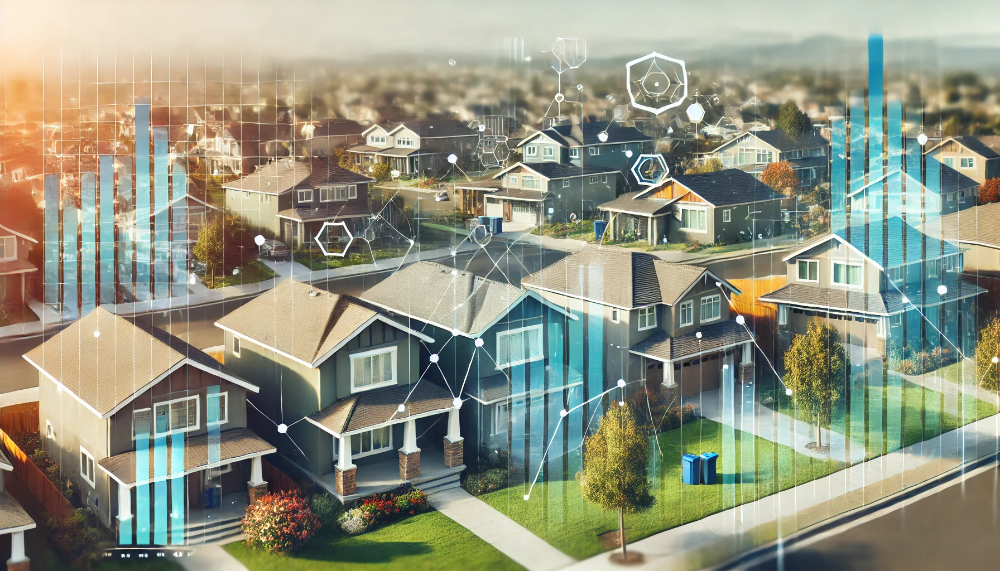

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import plotly.express as px
from collections import Counter

In [4]:
original_df = pd.read_csv('final_houses.csv', sep = ',' , encoding = 'utf-8')
original_df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Playgrounds in 15Km,Sports Centers in 15Km,Pitches in 14Km,Stations in 18Km,Bus Stations in 18Km,Schools in 14Km,Kindergartens in 14Km,Clinics in 17Km,Doctors in 16Km,Pharmacies in 15Km
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,761.0,82.0,71.0,121.0,14.0,11.0,173.0,290.0,199.0,448.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,760.0,83.0,71.0,121.0,14.0,11.0,171.0,289.0,199.0,449.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,755.0,83.0,72.0,121.0,14.0,11.0,173.0,289.0,199.0,450.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,761.0,82.0,71.0,121.0,14.0,11.0,173.0,290.0,199.0,448.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,760.0,83.0,71.0,121.0,14.0,11.0,171.0,289.0,199.0,449.0


In [5]:
original_df['Method']=original_df['Method'].replace({'S':'Sold',
                     'SP':'Sold Prior',
                     'PI':'Passed In',
                     'PN': 'Sold Prior not disclosed',
                     'SN':"Sold Not Disclosed",
                     'NB':'No Bid',
                     'VB':'Vendor Bid',
                     'W':'Withdrawn Prior To Auction',
                     "SA": "Sold After Auction",
                     "SS":"Sold After Auction Price Not Disclosed",
                     "N/A":None})
original_df['Type'] = original_df['Type'].replace({
    'br': 'bedroom(s)',
    'h': 'house,cottage,villa, semi,terrace',
    'u': 'unit, duplex',
    't': 'townhouse',
    'dev site': 'development site',
    'o res': 'other residential'
    })

In [6]:
original_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26629 entries, 0 to 26628
Data columns (total 42 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Suburb                          26629 non-null  object 
 1   Address                         26629 non-null  object 
 2   Rooms                           26629 non-null  int64  
 3   Type                            26629 non-null  object 
 4   Price                           26629 non-null  float64
 5   Method                          26629 non-null  object 
 6   SellerG                         26629 non-null  object 
 7   Date                            26629 non-null  object 
 8   Distance                        26629 non-null  float64
 9   Postcode                        26629 non-null  float64
 10  Bedroom2                        20533 non-null  float64
 11  Bathroom                        20527 non-null  float64
 12  Car                             

In [7]:
original_df.isnull().sum()

Suburb                                0
Address                               0
Rooms                                 0
Type                                  0
Price                                 0
Method                                0
SellerG                               0
Date                                  0
Distance                              0
Postcode                              0
Bedroom2                           6096
Bathroom                           6102
Car                                6475
Landsize                           8889
BuildingArea                      16139
YearBuilt                         14723
CouncilArea                           0
Latitude                              0
Longitude                             0
Regionname                            0
Propertycount                         0
Distance to nearest Hospital          0
Distance to nearest University        0
Distance to nearest Coastline         0
Bars in 18Km                          0


Due to previous processing we know we won't have any missing values in new features and price.  
Although it is important to check for duplicates. We omit address since it is likely to be unique so we omit it to see the real duplicates.

In [9]:
original_df.drop(['Address'],axis=1).duplicated().sum()

7

In [10]:
# Drop them!
print(original_df.drop(['Address'],axis=1).drop_duplicates(inplace=True))

None


We now have an idea about missing values and duplicates so we proceed by exploring or data.  
After processing the data and crafting new features we need to do a lot of exploration.  
There are several things to take into account during this EDA:
* The original data it self is not reliable.
* The new features can be used for visual analysis but we didn't design a specific experiment. So we can't go the path of statistical inference.
* From the correlation matrix we saw in the notebook we will have to deal with a lot of multicollinearity.

Problems that will arise due to multicollinerity:  
* For models with interpretable coeffecients (e.g. Linear Regression and mixed effects and interaction models fitted using OLS) :
  * The model can't separate the effects of correlated variables. Although in statistical inference we can use the technique of partialing out correlated variables it will be hard to do this for the number of variables we have.
  * Coefficients may inflate or deflate due to the correlation of the variables. This would happen even if the variable has high correlation with the target.
  * The signs might change. A variable that should be positive might have a negative coeffecient due to its correlation with another variable.
* For standard erros:
  * We get wider confidence intervals because of inflated standard erros.
  * Reduced statistical power especially in regression when doing ANOVA.
  * High variability in the coeffecients as they become too sensitive for small changes in the data. So the model **oeverfits** the data
* Hypothesis testing:
  * The p-values will inflate (remember the standard errors) making t-test invalid.
  * The presence of more predictors will increase the R-squared value for the fit which in turn will provide a significant F-value. But fitting the model using individual predictors will yield insignificant F-values and low R-squared. So due to there dependence they will *collectively* provide information about the dependent variable, but in truth some variables may not provide enough information.
* Of course we expect overfitting and poor generalizability but why? this is maths:
  * For models fitted using OLS which relys on matrix inversion, The predictor's matrices will simply have large determinants (so nearly singular) and matrix inversion becomes unstable
  * When solving the normal equations for OLS the process becomes sensitive to small changes in data.
    
For this we will focus on addressing multicollinearity directly after analysing and visualizing the data to understand it.  
After this we go through the process of feature selection then prediction. Note that due to multicolleniarity feature selection using filter methods (e.g. correlation , ANOVA, and mutual information criterion.) should not be used before addressing multicolleniarity.

## Exploring The Data

In [13]:
# Copy the dataframe for safer processing
df = original_df.copy()

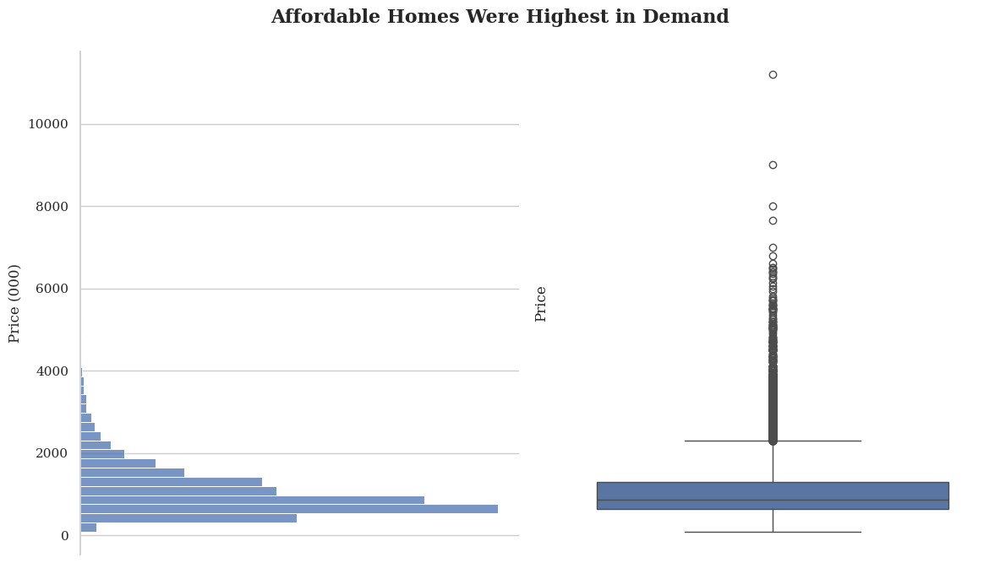

In [14]:
# Set the style for consistency
sns.set(style="whitegrid")
plt.rcParams['font.family'] = 'serif'

# Create subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 7))

# Plot the histogram of Price with improvements
sns.histplot(y=df['Price'] / 1e3, ax=axes[0], bins=50)
sns.boxplot(data=df['Price'] / 1e3, ax=axes[1] )

# Customize the spines and background
axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)
axes[0].spines['bottom'].set_visible(False)

axes[1].spines['top'].set_visible(False)
axes[1].spines['right'].set_visible(False)
axes[1].spines['left'].set_visible(False)
axes[1].spines['bottom'].set_visible(False)

# Remove unnecessary ticks
axes[0].set_xticks([])
axes[1].set_xticks([])
axes[1].set_yticks([])

# Customize the axis labels
axes[0].set_ylabel('Price (000)', fontsize=12)
axes[0].set_xlabel('')  # No xlabel necessary for the histogram

# Add a title
fig.suptitle('Affordable Homes Were Highest in Demand', fontsize=16, weight='bold', y=0.95)

# Adjust the layout
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Display the plot
plt.show()


What do we see here? A very skewed distribution and one to four outliers in price.  
In business terms the demand for affordable homes was the biggest and only a select few could afford luxury homes. So the affordable market was saturated but the luxury market had a relatively lower demand.  Is it much lower than previous years? we can't determine this from the data we have here. Weather this is normal for the australian market or not can't be determined from *this* data.  
Let's look at a transformed version.

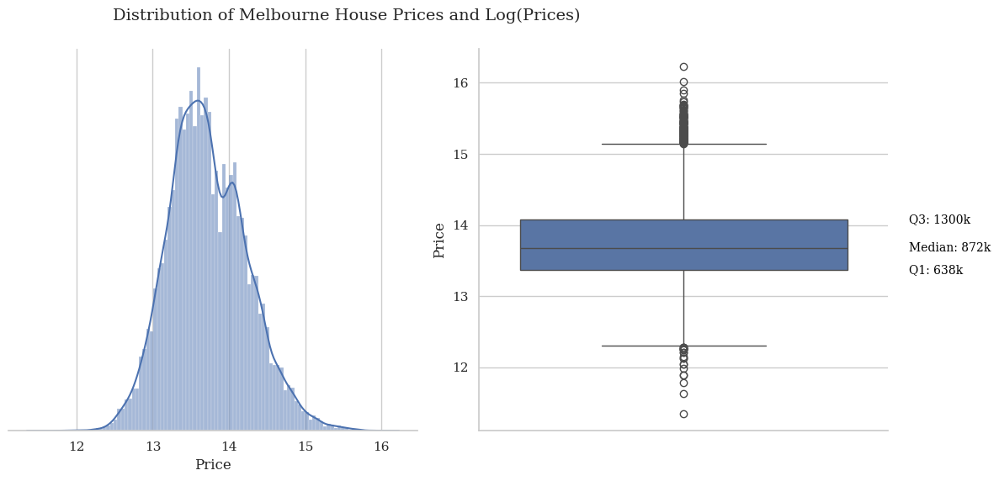

In [16]:
# Create a 1x2 figure
fig, axes = plt.subplots(nrows=1, ncols=2)
plt.rcParams['font.family'] = 'serif'

# Plot the second row with log-transformed data
sns.histplot(data=np.log(df['Price']), ax=axes[0], kde=True)
sns.boxplot(data=np.log(df['Price']), ax=axes[1])

# Customize second row plots (log-transformed data)
axes[ 0].spines['top'].set_visible(False)
axes[ 0].spines['right'].set_visible(False)
axes[0].spines['left'].set_visible(False)
axes[1].spines['top'].set_visible(False)
axes[1].spines['right'].set_visible(False)
axes[0].set_ylabel('')
axes[0].set_yticks([])

# Annotate quartiles for the log-transformed boxplot
quartiles_log = np.percentile(np.log(df['Price']), [25, 50, 75])
for i, quartile in enumerate(['Q1', 'Median', 'Q3']):
    axes[1].text(1.05, quartiles_log[i], f'{quartile}: {int(np.round(np.exp(quartiles_log[i]), 4)/1e3)}k', 
                    verticalalignment='center', fontsize=10, color='black', transform=axes[1].get_yaxis_transform())

# Adjust figure size and title
fig.set_size_inches(12, 6)
fig.suptitle('Distribution of Melbourne House Prices and Log(Prices)', fontsize=14, x=0.35, y=.95)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

So we have 75% of the houses priced at less than `1300K`. With this kind of skew we can fix the shape of the distribution by using a **squishing function** transformation (a function that grows slowly, doesn't have to converge, but grows slowly). Like *roots*, *logarithms*, *box-cox* and more. Here we only applied the Logarithm and it did the magic.

We are mostly interested in understanding what affects the vlaue of a house and we expect a lot of factors to play a role. Facilities give more value and require more area, Furnishing or even the material, Location and purpose of the property, inflation rate, Country safety, and a lot more...  

What we really need to pay attention to during analysis and drawing any conclusion is confounding variables. This basically means that we might have a variable that we believe affects the price while in fact this effect is only present because of another variable related to it. Think of it shark attacks and ice-cream sales, while we might believe ice-cream sales and shark attacks are related, this relation only exists through temperature especially in summer since more people buy ice-cream at the beach and more people are in water and consequently more vulnrable to shark attacks.
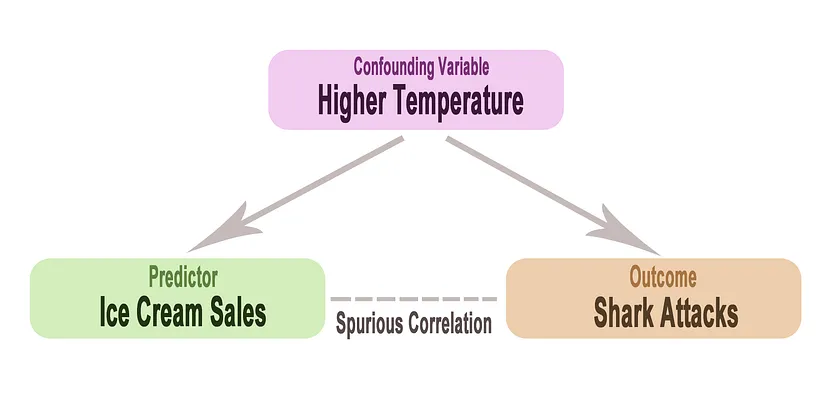  
What we have here is scraped data from more than one source. This surely comes with uncertainty and expected amount of error, so we will try to pay attention to very big outliers at least.  
We sure are lucky to have a lot of variables to explore. Mainly:
 * Location
 * Date
 * Facilities
 * And property merits like land size and Age. 

We have a lot of missing values so we will explore the data we have enough observations of.  
First let's explore **location**:  
*Author note: *Those graphs were harder than they look*. I had to first search for 3 hours for the polygon data for the suburbs. Then had tried to directly map the median prices to the map which at first looked alright but after manual checks turned out everything was out of order so I had to edit the geojson THEN use the data from it in the mapping. Yes chat GPT was a lot of help but it's furustrating*.

In [19]:
import json
import plotly.graph_objects as go
df.loc[:,'Suburb']= df.loc[:,'Suburb'].apply(lambda X: X.upper())
# Load GeoJSON data
with open('D:/Portfolio Projects/Data/suburb-2-vic.geojson') as f:
    geojson_data = json.load(f)

In [20]:
df['LogPrice'] = np.log(df['Price'])

In [21]:
# Group the data by suburb and aggregate price using median
price_dict = df.groupby(['Suburb'])['LogPrice'].quantile(0.75).to_dict()
property_cnts_dict = df.groupby(['Suburb'])['LogPrice'].count().to_dict()
# Update GeoJSON properties with median prices
# Each feature is essentially an object that has the information of the suburb
for feature in geojson_data['features']:
    # We have a lot of information but the nested information we are looking for are in the properties
    # YES the suburb name is called vic_loca_2 and loca is kinda angry because we searched for him a lot ... Sorry :)
    suburb = feature['properties']['vic_loca_2']
    if suburb in price_dict:
        # add the Median price and remember that we index the dictionary using the key
        feature['properties']['LogPrice'] = price_dict[suburb]
        feature['properties']['#samples'] = property_cnts_dict[suburb]
    else: 
        feature['properties']['LogPrice'] = None  # Or some default value

In [22]:
import plotly.graph_objects as go

# Define a lighter, more balanced blue colorscale
custom_colorscale = [
    [0, 'rgb(240,248,255)'],  # Very light blue
    [0.125, 'rgb(173,216,230)'],  # Light blue
    [0.25, 'rgb(135,206,250)'],  # Sky blue
    [0.375, 'rgb(70,130,180)'],  # Steel blue
    [0.5, 'rgb(65,105,225)'],  # Royal blue
    [0.625, 'rgb(0,0,255)'],  # Blue
    [0.75, 'rgb(0,0,205)'],  # Medium blue
    [0.875, 'rgb(25,25,112)'],  # Midnight blue
    [1.0, 'rgb(0,0,139)']  # Dark blue, but lighter than before
]

In [23]:
# Create the choropleth map
fig = go.Figure(go.Choroplethmapbox(
    geojson=geojson_data,
    locations=[feature['properties']['vic_loca_2'] for feature in geojson_data['features']],
    featureidkey="properties.vic_loca_2",
    z=[feature['properties'].get('LogPrice', 0) for feature in geojson_data['features']],  # Use the median log price for color
    colorscale=custom_colorscale,
    showscale=True,
    marker_opacity=0.85,  # Slightly increase opacity for better contrast
    marker_line_width=0.5,  # Subtle boundary lines
    hovertext=[f"<b>Suburb:</b> {feature['properties']['vic_loca_2']}<br>"
               f"<b>75% of houses below:</b> {f'{feature['properties'].get('LogPrice', 0):.3f}' if feature['properties'].get('LogPrice') is not None else 'No Data'}<br>"
               f"<b>Sample size:</b> {feature['properties'].get('#samples', 'N/A')}"
               for feature in geojson_data['features']],
    hoverinfo="text"
))


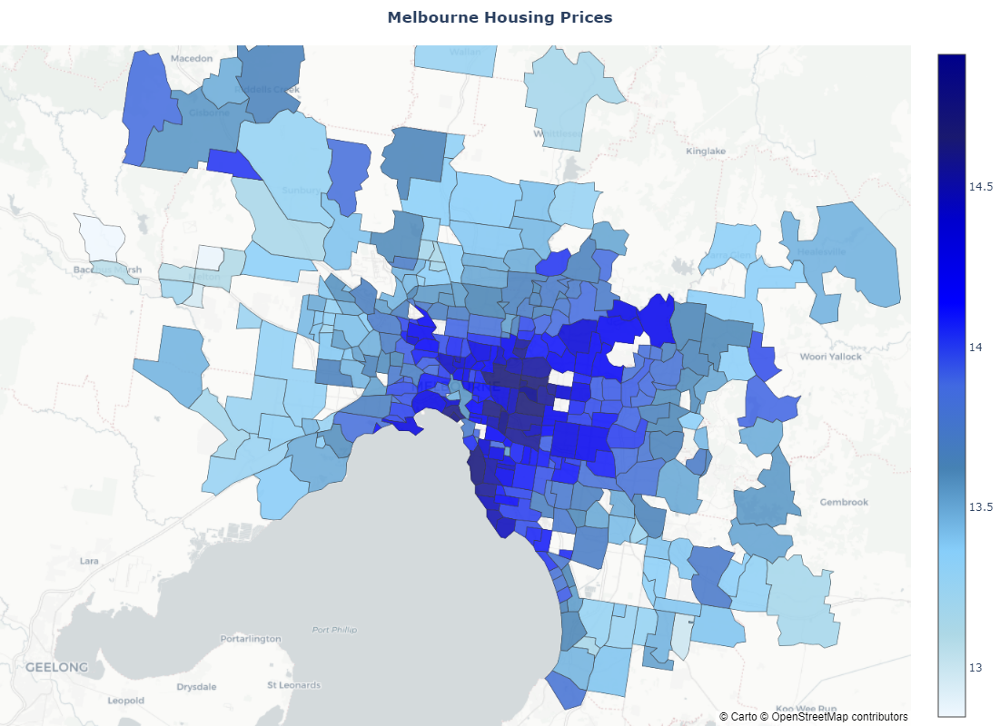

In [24]:
# Update map layout with improvements
fig.update_layout(
    title="<b>Melbourne Housing Prices</b>",  # Add a descriptive title
    title_x=0.5,  # Center the title
    mapbox_style="carto-positron",  # Clean and modern map style
    mapbox_zoom=9,  # Slight zoom out for a broader view
    mapbox_center={"lat": -37.8136, "lon": 144.9631},  # Center on Melbourne
    width=1100,  # Adjusted width for a balanced layout
    height=800,  # Height suitable for desktop view
    margin={"r":0, "t":50, "l":0, "b":0},  # Tighten margins for a clean look
    coloraxis_colorbar={
        'title': 'Median Log Price',  # Add title to the color scale
        'titleside': 'right',
        'tickvals': [0, 1, 2, 3, 4],  # Example tick values for color scale
        'ticktext': ['Low', 'Moderate', 'High', 'Very High', 'Extremely High'],  # Labels for the color bar
    }
)
# Show the figure
fig.show()

***Too much suffering later***
The dark blue shows suburbs where the third quartile of log(price) is high. So what can we visually deduce from this?
* The highest prices seem to be in the east side of Melbourne. The center of course is expensive and we want to explore these areas.
* The coastline especially seems to be more expensive than the outskirts, that's a claim to verify.  
* There are suburbs with very high prices and the suburbs around them are also high, but not THAT high. Maybe they have something that makes them valuable and makes being near them also valuable.
I want to check the last note. for this, I will inspect: Middle Park,  Malvern, Canterbury, Brighton and a couple of suburbs to the south.

**Middle Park**: it's expensive for its own merits. It has a beach so it is naturally expensive. Also, it has a very prestigious school making it so appealing to families. It's quiet, and it's 4 Kilometers from the city center. Its neighbor Albert Park is also expensive for being so close to it but it has Albert Park College and a number of private schools. This makes it valuable for families.

**Malvern**: For shoppers, Malvern offers its renowned commercial site, Malvern Central. For students, there is the prestigious De La Salle College. This is an affluent suburb known for its elegant homes, green spaces, and vibrant shopping districts. Victorian architecture is also prevalent in many of the properties here.

**Canterbury**: Canterbury is a suburb known for its elegance and sophistication. There are also numerous tree-lined streets and green boulevards in this suburb. The famed Golden Mile can be found on Canterbury's Mont Albert Road. It's an area filled with huge oak trees, and luxurious mansions, and is known to be the residence of many business leaders and politicians. For suburbs around it like **Kew** and **Balwyn** they share the same merits, They got big and luxurious mansions with tree-lined streets and near CBD.

**Brighton**: This suburb is rich in scenic landmarks and tourist destinations. It also has many sport clubs. Also, it has Grand mansions that attract lots of the elites. The idea of being near the beach, having a nice scene, grand mansions, and tree-lined streets continues on with suburbs on the south coast near it.

These are all reasons for those areas to be expensive. Such knowledge comes from experts who sell these houses there from people's opinions on Reddit.  
What are the most expensive suburbs?

In [26]:
suburb_counts = df.groupby('Suburb')['Type'].count().sort_values(ascending=False)
suburb_counts[suburb_counts>=30]

Suburb
RESERVOIR         715
BENTLEIGH EAST    487
RICHMOND          424
PRESTON           403
BRUNSWICK         377
                 ... 
TAYLORS HILL       32
VERMONT SOUTH      32
MCKINNON           31
ESSENDON WEST      31
MELTON             30
Name: Type, Length: 211, dtype: int64

In [27]:
suburb_30 = df[df['Suburb'].isin(suburb_counts[suburb_counts>=30].index)]
aggregated_suburb = suburb_30.groupby('Suburb')['Price'].quantile([.25, .5, .75]).unstack().reset_index()
aggregated_suburb.columns = ['Suburb','Q1','Q2','Q3']

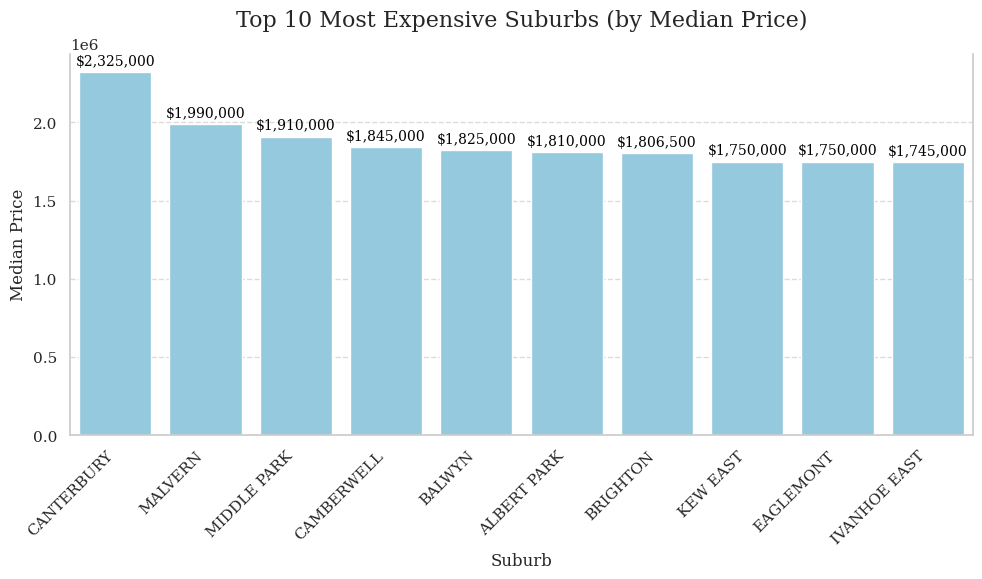

In [28]:
# Set the style
sns.set(style="whitegrid")
plt.rcParams['font.family'] = 'serif'

# Create the bar plot without palette
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=aggregated_suburb.sort_values(by='Q2', ascending=False).iloc[0:10], 
                 x='Suburb', y='Q2', color='skyblue')  # Manually set color instead of palette

# Rotate the labels by 45 degrees for better readability
plt.xticks(rotation=45, ha='right')
# Add title and labels
plt.title('Top 10 Most Expensive Suburbs (by Median Price)', fontsize=16,y=1.05)
plt.ylabel('Median Price', fontsize=12)

# Add a grid for better readability
ax.grid(True, axis='y', linestyle='--', alpha=0.7)
ax.spines['top'].set_visible(False)
# Annotate the bars with exact Q2 values
for p in ax.patches:
    ax.annotate(f'${int(p.get_height()):,}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 8),
                textcoords='offset points')

# Show the plot
plt.tight_layout()
plt.show()

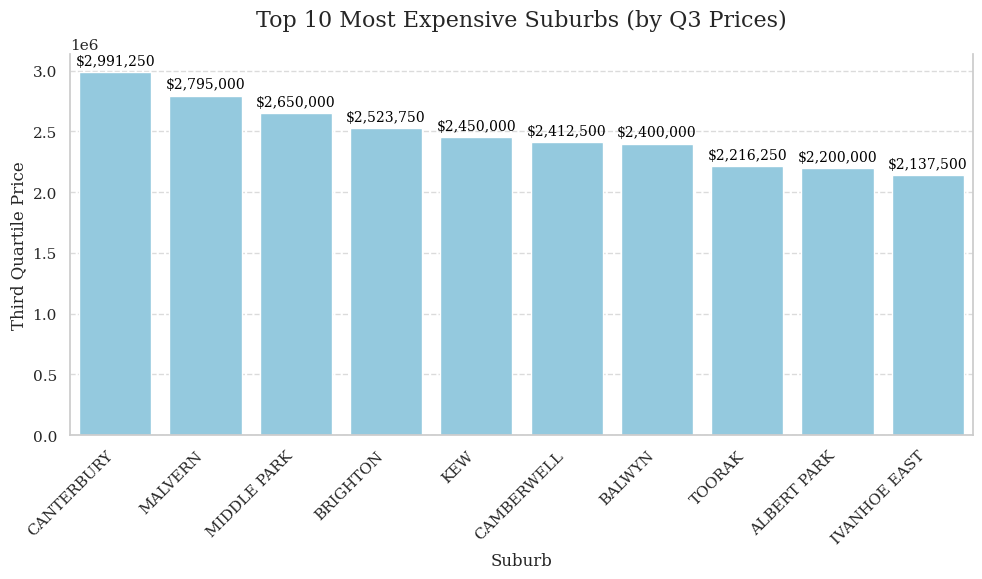

In [29]:
# Set the style
sns.set(style="whitegrid")
plt.rcParams['font.family'] = 'serif'

# Create the bar plot for Q3 without palette
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=aggregated_suburb.sort_values(by='Q3', ascending=False).iloc[0:10], 
                 x='Suburb', y='Q3', color='skyblue')  # Manually set color

# Rotate the labels by 45 degrees for better readability
plt.xticks(rotation=45, ha='right')

# Add title and labels
plt.title('Top 10 Most Expensive Suburbs (by Q3 Prices)', fontsize=16,y=1.05)
plt.xlabel('Suburb', fontsize=12)
plt.ylabel('Third Quartile Price', fontsize=12)

# Add a grid for better readability
ax.grid(True, axis='y', linestyle='--', alpha=0.7)
ax.spines['top'].set_visible(False)
# Annotate the bars with exact Q3 values
for p in ax.patches:
    ax.annotate(f'${int(p.get_height()):,}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 8),
                textcoords='offset points')

# Show the plot
plt.tight_layout()
plt.show()

We excluded suburbs with less than 30 samples as they are much less likely to really be representative. If we are looking at it from the distribution side it's too little to form a distribution.  
Why not use bootstrapping? we can't assume random sampling so even for suburbs with 10+ samples we can't go for.  

*Note:*  
As mentioned earlier we expect there to be errors. so we have two solutions:  
* Use an API to pull this information from a real estate site. Except this will cost money.
* Manually check values that stand out too much. This is cheaper but time-consuming.

Now these observations make sense, A lot! But, before making further conclusions we need to look at the samples we have on the map

In [32]:
# Copy the dataframe to create hover text
temp_df = df.copy()

# Create hover text that displays relevant information
temp_df['hover_text'] = df.apply(lambda row: (
    f"<b>Address:</b> {row['Address']}<br>"
    f"<b>Suburb:</b> {row['Suburb']}<br>"
    f"<b>Price:</b> ${row['Price']:,}<br>"
    f"<b>Bedrooms:</b> {row['Rooms']}<br>"
), axis=1)


In [33]:
custom_colorscale = [
    [0, 'rgb(240,248,255)'],
    [0.125, 'rgb(173,216,230)'],
    [0.25, 'rgb(135,206,250)'],
    [0.375, 'rgb(70,130,180)'],
    [0.5, 'rgb(65,105,225)'],
    [0.625, 'rgb(128,0,128)'],
    [0.75, 'rgb(139,0,139)'],
    [0.875, 'rgb(148,0,211)'],
    [1.0, 'rgb(75,0,130)']
]

# Create the scatter mapbox plot
prices_fig = go.Figure(go.Scattermapbox(
    lat=df['Latitude'],  # Latitude values
    lon=df['Longitude'],  # Longitude values
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=5,  # Marker size
        color=df['LogPrice'], 
        colorscale=custom_colorscale,
        opacity=0.75,  
        showscale=True
    ),
    text=temp_df['hover_text'],
    hoverinfo='text'
))

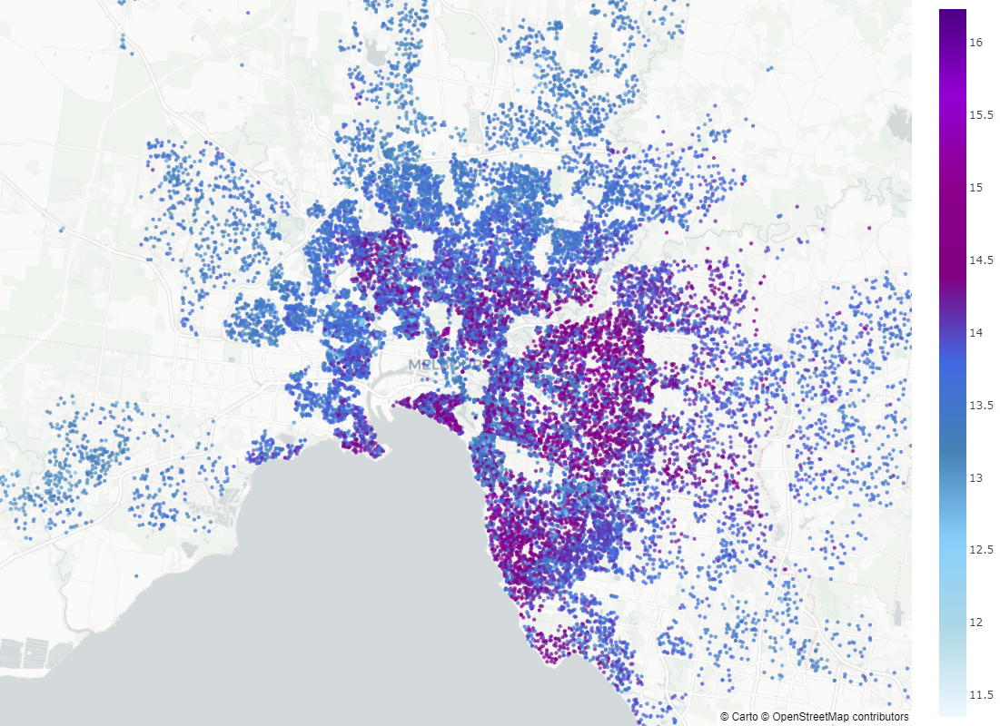

In [34]:

# Update layout for the map, including zoom and center on Melbourne
prices_fig.update_layout(
    mapbox_style='carto-positron',
    mapbox_zoom=10,
    mapbox_center={"lat": -37.8136, "lon": 144.9631},
    width=1000,
    height=800,
    margin={"r":0, "t":0, "l":0, "b":0}
)

# Show the figure
prices_fig.show()

# Clean up temporary dataframe
del temp_df

I think this looks beautiful but beauty isn't the goal here. Rather This should show us visually the disparity in the number of samples we have for each area.  

So what? If we only rely on the first map then we will face an issue. I didn't comment on the code that displays the number of samples on purpose. If we look at kyoong we only have 3 samples, Deepdene is 5, canterbury is 72. So we have more samples to estimate for Canterbury than several other areas combined.  

This makes statistical inference and comparison between different suburbs invalid. This would have been different if we had 5 samples for each suburb for example.

Later during modeling, we will also face the problem of encoding those different suburbs and separating their effects. For now, we continue exploration.  
But let's examine suburbs that have more than 30 samples.

**Now we explore the number of rooms**

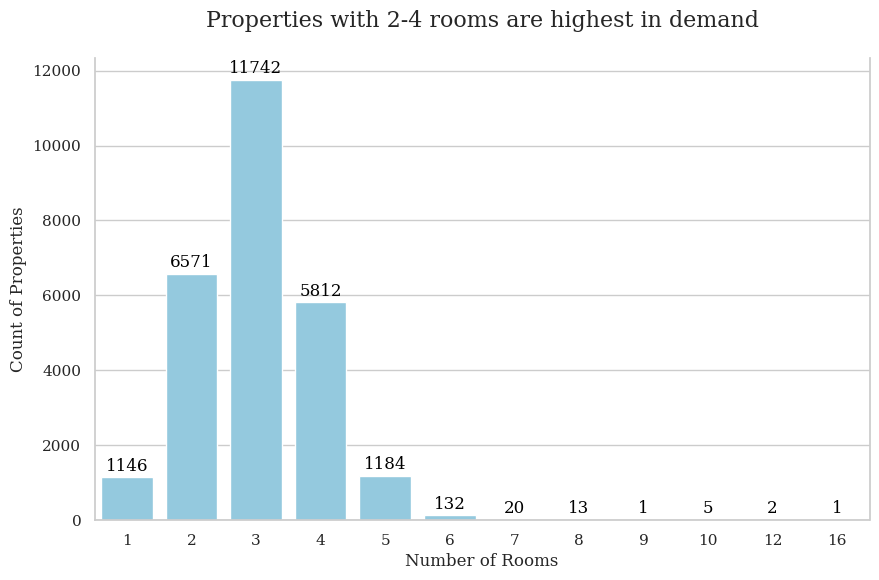

In [37]:
sns.set(style="whitegrid")
plt.rcParams['font.family'] = 'serif'

plt.figure(figsize=(10, 6))
ax = sns.countplot(x=df['Rooms'], color='skyblue')

# Add labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='baseline', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')
ax.spines['top'].set_visible(False)
# Add title and labels
plt.title('Properties with 2-4 rooms are highest in demand', fontsize=16,y=1.05)
plt.xlabel('Number of Rooms', fontsize=12)
plt.ylabel('Count of Properties', fontsize=12)

# Show the plot
plt.show()


2-4 rooms is the norm any more than this seems to be too rare.  
The market demand for properties with 5 or more rooms is relatively small. This could indicate the existance of a **niche** market with specific needs that could be a defferenciating point. Also, depending on the number of competitors, breaking into this market with a small number of properties targeted at this market might be a good idea but the demand at this time suggests that it might be risky to focus on it solely.

We want to check if there is an association between the number of rooms and price. We can do this using something like analysis of variance but the normality of errors is nearly impossible so we look at spearman's correlation coeffecient which uses ranking instead. This method checks for monotonic relationsh without assuming normality so a lot of headache saved

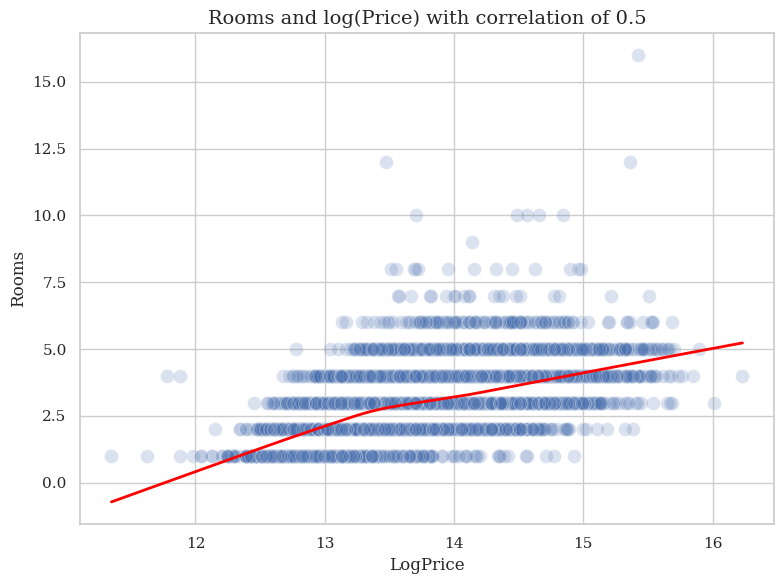

In [40]:
from scipy.stats import spearmanr


corr, p_value = spearmanr(df['Rooms'], df['LogPrice'])
plt.rcParams['font.family'] = 'serif'


plt.figure(figsize=(8, 6))
ax = sns.scatterplot(y=df['Rooms'], x=df['LogPrice'], alpha=0.2, s=100)

# Add title with correlation value
ax.set_title(f'Rooms and log(Price) with correlation of {np.round(corr, 2)}', fontsize=14)
ax.set_xlabel('Log of Price', fontsize=12)
ax.set_ylabel('Number of Rooms', fontsize=12)

sns.regplot(x=df['LogPrice'], y=df['Rooms'], scatter=False,lowess=True, ax=ax, color='red', line_kws={"linewidth": 2})

# Show the plot
plt.tight_layout()
plt.show()

Well, then the number of rooms has a positive **monotonic** relationship with price which is relatively strong. We will do some manual processing later.  
  
So A higher number of rooms means a higher price.  
One question comes to my is wether the type of the property affects the number of rooms. We prooced to check this.

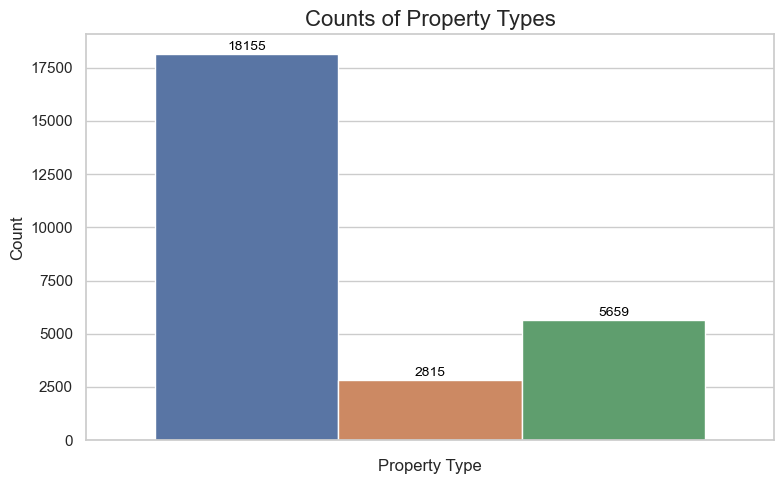

In [42]:
type_counts = Counter(df['Type'])

# Convert the Counter object to a DataFrame for easier plotting
type_counts_df = pd.DataFrame(list(type_counts.items()), columns=['Type', 'Count'])

# Set the style
sns.set(style="whitegrid")

# Create a bar plot for the type counts
plt.figure(figsize=(8, 5))
ax = sns.barplot( y='Count', data=type_counts_df, hue='Type',legend=False)

# Add title and labels
plt.title('Counts of Property Types', fontsize=16)
plt.xlabel('Property Type', fontsize=12)
plt.ylabel('Count', fontsize=12)

# Annotate the bars with exact counts
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

# Show the plot
plt.tight_layout()
plt.show()

after Some manual inspection I found some faulty data points. Although the error rate seems not good.

In [44]:
df.loc[5712,'Rooms'] = 6
df.loc[5765,'Rooms'] = 2
df.loc[20145,'Rooms'] = 3
df.loc[20145,'Type'] = 'townhouse'
df.loc[20848,'Rooms'] = 6
df.loc[2500,'Rooms'] = 3 
df.loc[7795,'Rooms'] = 5

Two categorical variables, how do we measure their relation?  
First and most popular way is chi-square test using contengency tables. But for such a test we need to have at least 5 samples in the contingency table for this to work. And as you see this is impossible.  
For this our experiment and interpretation for the last category will be that of 6+ rooms. Collapsing these categories solves the issue and here are the counts after collapsing them.

In [46]:
from scipy.stats import chi2_contingency
from scipy.stats.contingency import association
df2 = df.copy()
df2['Rooms'] = df2['Rooms'].apply(lambda X: 6 if X>=6 else X)
contingency_table = pd.crosstab(df2['Type'],df2['Rooms'])
chi2_stat, p_val, dof, expected = chi2_contingency(contingency_table)
print('Chi-squared =',chi2_stat)
print('P-value =', p_val)

Chi-squared = 11078.460654618855
P-value = 0.0


How do we interpret this?  
This means that the null hypothesis which states that there is no difference between classes in the **population** is rejected.  
Using the same table we can measure association of the two tables using cramer's V. Such test is important as such tests with imbalanced counts in different categories might give more statistical power to those with large counts, so we also apply correction.

In [48]:
association(contingency_table,method= 'cramer',correction=True)

0.4560865689787933

So we got **moderate** asscoiation.  
To confirm this visually, Let's check the frequencies we observed and the frequencies we expected.

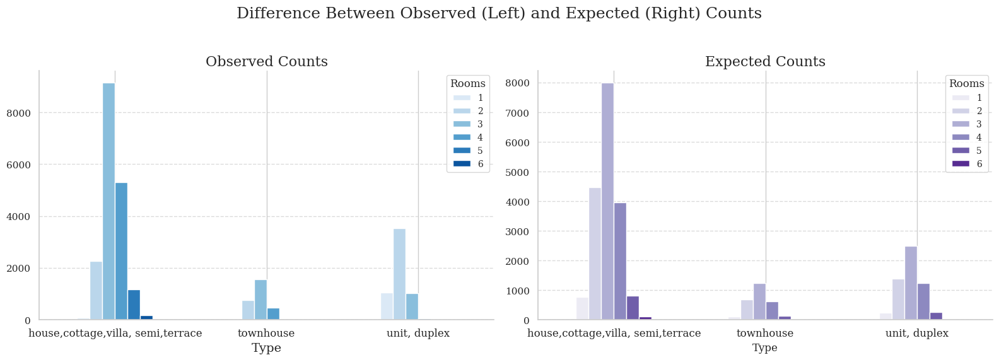

In [50]:
expected_df = pd.DataFrame(expected, index=contingency_table.index, columns=contingency_table.columns)
plt.rcParams['font.family'] = 'serif'

# Set up the figure and axes
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))
fig.suptitle("Difference Between Observed (Left) and Expected (Right) Counts", fontsize=18)

# Plot observed frequencies on the left
contingency_table.plot(kind='bar', stacked=False, ax=axes[0], color=sns.color_palette("Blues", n_colors=6))

# Customize the left axis plot
axes[0].set_title("Observed Counts", fontsize=16)
axes[0].set_xlabel("Type", fontsize=14)
axes[0].set_ylabel("")
axes[0].tick_params(axis='x', rotation=0, labelsize=12)
axes[0].legend(title='Rooms', loc='upper right', fontsize=10, title_fontsize=12)
# Plot expected frequencies on the right
expected_df.plot(kind='bar', stacked=False, ax=axes[1], color=sns.color_palette("Purples", n_colors=6))

# Customize the right axis plot
axes[1].set_title("Expected Counts", fontsize=16)
axes[1].set_xlabel("Type", fontsize=12)
axes[1].set_ylabel("")
axes[1].tick_params(axis='x', rotation=0, labelsize=12)
axes[1].legend(title='Rooms', loc='upper right', fontsize=10, title_fontsize=12)

# Clean up the axes and layout
for ax in axes:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to prevent overlap
plt.show()

The left image shows what the distributions should look like if there was no association between types and # of rooms.  
So visually we can see the difference and it is significant.  
One might say, ok so what type of properties is more likely to have what one number of rooms than all? e.g. are townhouses more likely to have 2 rooms than any other type?  
To test this we test for proportions pairwise using a standard Z-score.

In [52]:
room_counts = df2.groupby(['Type', 'Rooms']).size().unstack(fill_value=0)
totals = room_counts.sum(axis=1)
proportions = room_counts.div(totals, axis=0)

In [53]:
from statsmodels.stats.proportion import proportions_ztest
from itertools import combinations

# Perform pairwise Z-tests for each room category
room_categories = room_counts.columns

# Loop through each room category and perform pairwise comparisons
for room in room_categories:
    print(f"\n{'-'*40}")
    print(f"Pairwise Z-tests for {room} Rooms")
    print(f"{'-'*40}\n")
    
    # Get the counts and totals for each property type for the current room count
    counts = room_counts[room]
    nobs = totals
    
    # Generate all pairwise combinations of property types
    comparisons = list(combinations(counts.index, 2))
    
    # Perform Z-tests for each pair of property types
    for i, j in comparisons:
        # Get the counts and sample sizes for the two property types
        count = [counts[i], counts[j]]
        nobs_pair = [nobs[i], nobs[j]]
        
        # Perform the Z-test
        stat, pval = proportions_ztest(count, nobs_pair)
        
        # Output the results in a formatted way
        print(f"Comparison between {i} and {j}:")
        print(f"  Z-statistic = {stat:.4f}")
        print(f"  P-value     = {pval:.4f}\n")

    print(f"{'-'*90}\n")


----------------------------------------
Pairwise Z-tests for 1 Rooms
----------------------------------------

Comparison between house,cottage,villa, semi,terrace and townhouse:
  Z-statistic = -1.4373
  P-value     = 0.1506

Comparison between house,cottage,villa, semi,terrace and unit, duplex:
  Z-statistic = -55.8987
  P-value     = 0.0000

Comparison between townhouse and unit, duplex:
  Z-statistic = -23.3811
  P-value     = 0.0000

------------------------------------------------------------------------------------------


----------------------------------------
Pairwise Z-tests for 2 Rooms
----------------------------------------

Comparison between house,cottage,villa, semi,terrace and townhouse:
  Z-statistic = -20.7643
  P-value     = 0.0000

Comparison between house,cottage,villa, semi,terrace and unit, duplex:
  Z-statistic = -76.3869
  P-value     = 0.0000

Comparison between townhouse and unit, duplex:
  Z-statistic = -30.4643
  P-value     = 0.0000

-----------------

Summary for all this:
* Units/duplexes are more likely to have 1-2 rooms.
* Townhouses tend to have 2-3 rooms more often than houses or units.
* Houses/Cottages/Villas/Semis/Terraces are more likely to have 4-6+ rooms, showing a tendency towards larger number of rooms.

Now we take the next variable which is the property `Type`. We already saw its relation with rooms.  
We are interested in their relationship with `Price`, # of `Car` slots and maybe `Date`.  
For the relationship with `Price` we can do Analysis of variance. One thing to note are the two assumptions made.  
- The Target is  **Approximately normally distributed**
- The variance among the groups are equal  

We could visually verify the first after transforming the price using logarithms. to verify the second we go with a statistical test and visualization.

In [56]:
from scipy.stats import levene

# Perform Levene's test for homogeneity of variances
levene_test = levene(df[df['Type'] == 'house,cottage,villa, semi,terrace']['LogPrice'],
                     df[df['Type'] == 'townhouse']['LogPrice'],
                     df[df['Type'] == 'unit, duplex']['LogPrice'])

print(f"Levene's test statistic: {np.round(levene_test.statistic,2)}\np-value: {np.round(levene_test.pvalue,2)}")

Levene's test statistic: 326.1
p-value: 0.0


There is statistically significant evidence that our data doesn't come from a population with equal variances among the groups.
Let's confirm visually.

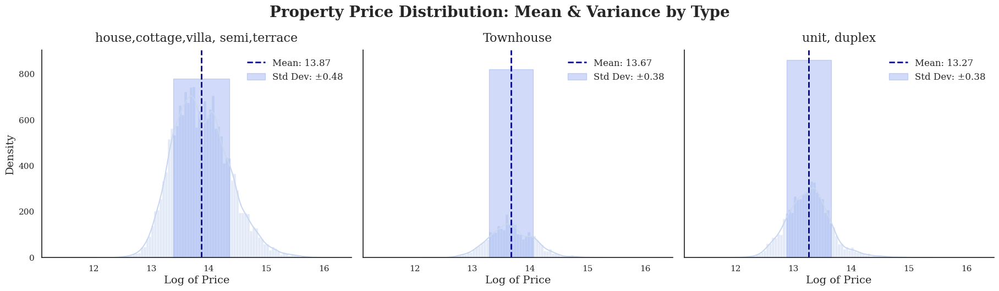

In [58]:
# Set minimalistic style
sns.set(style="white", rc={"axes.spines.right": False, "axes.spines.top": False})

# Define a more saturated color palette
palette = sns.color_palette("coolwarm", as_cmap=False)

# Use a nicer font (if available)
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14  # Increase the base font size for better readability

# Increase the height and aspect ratio
g = sns.displot(
    data=df,
    x="LogPrice",
    col="Type",
    kde=True,
    height=4.9,  # Slightly taller height for better visibility
    aspect=1.25,  # Wider aspect ratio to accommodate titles and legends
    col_wrap=3,
    fill=True,  # Fill the KDE area for aesthetic appeal
    color=palette[2],  # Use a more saturated and pleasing color
)

# Flatten the axes array for easier iteration
axes = g.axes.flatten()

# Set custom titles for each plot
custom_titles = {
    'house,cottage,villa,semi,terrace': 'House, Cottage, Villa, Semi-Terrace',
    'townhouse': 'Townhouse',
    'unit,duplex': 'Unit, Duplex'
}

# Add vertical lines for mean and shading for variance (1 standard deviation)
for ax, category in zip(axes, df['Type'].unique()):
    # Compute the mean and standard deviation for the current category
    mean_value = df[df['Type'] == category]['LogPrice'].mean()
    std_value = df[df['Type'] == category]['LogPrice'].std()
    
    # Plot the vertical line at the mean
    ax.axvline(mean_value, color='darkblue', linestyle='--', linewidth=2, label=f'Mean: {mean_value:.2f}')
    
    # Plot shading for 1 standard deviation around the mean
    ax.fill_betweenx(
        ax.get_ylim(), mean_value - std_value, mean_value + std_value,
        color=palette[0], alpha=0.3, label=f'Std Dev: ±{std_value:.2f}'
    )
    
    # Set the custom title for each plot
    ax.set_title(custom_titles.get(category, category), fontsize=16, weight='normal',y=1.02)
    
    # Add the legend to each plot in a subtle way
    ax.legend(loc='upper right', fontsize=12, frameon=False)
    
    # Make the x-axis labels less cluttered
    ax.set_xlabel('Log of Price', fontsize=14)
    ax.set_ylabel('Density', fontsize=14)

# Adjust the title and overall plot styling
g.fig.suptitle('Property Price Distribution: Mean & Variance by Type', y=1.08, fontsize=20, weight='bold')


# Show the plot
plt.show()

Homes distribution seems a bit bimodal, Townhouse have heavier tales, and units are not symmetrical.
How do we treat this? we simply use Welch's ANOVA which relaxes this assumption.  

In [60]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

# Fit the model using OLS for Welch's ANOVA
model = ols('Price ~ Type', data=df).fit()

# Perform Welch's ANOVA using the model's output
welch_anova = sm.stats.anova_lm(model, typ=2, robust='hc3')
print(welch_anova)

                sum_sq       df            F  PR(>F)
Type      2.914276e+15      2.0  4071.942113     0.0
Residual  9.528072e+15  26626.0          NaN     NaN


The test shows there is statistically significant difference in the mean among different types of properties.  
For more clarity we can see what groups differ significantly using a pairwise test.

In [62]:
import pingouin as pg


games_howell_result = pg.pairwise_gameshowell(dv='LogPrice', between='Type', data=df)

log_differences = games_howell_result['diff']

# Convert them to percentage differences
percentage_differences = (np.exp(log_differences) - 1) * 100

# Add the percentage differences to the original Games-Howell result DataFrame
games_howell_result['Percentage Difference'] = percentage_differences

games_howell_result[['A', 'B', 'diff', 'Percentage Difference', 'pval']]

,A,B,diff,Percentage Difference,pval
0,"house,cottage,villa, semi,terrace",townhouse,0.203219,22.534048,1.224354e-12
1,"house,cottage,villa, semi,terrace","unit, duplex",0.605218,83.165070,4.122258e-12
2,townhouse,"unit, duplex",0.401999,49.480959,3.365086e-13


* Houses are about **22.62%** more expensive than townhouses and **83.18%** more expensive than units and duplexis.
* Townhouses are **49.38%** more expensive than units and duplixes.  

So, Houses are more expensive than townhouses which are more expensive than units and duplixes. Also, we see that the difference between houses and townhouses is much smaller than the difference between townhouses and units, but *Why* does it matter?
This simply means that transitioning from owning a unit to owning a penthouse is much harder than transitioning from a penthouse to a villa or cottage of somesort. Such transitions would imply that some income levels will always be stuck living in units or duplixes.  
If we had more data we could thought more about what this might imply, having demographic data of the owners could have told us something about the community, having more data at different suburbs could have helped in exploring what type of property is more present at which suburb so this could have add some information to the analysis. But we are trying to make do with what we have.  


Next let's look at the number of parking slots available for each type. We have thousands of missing values so unfortunately we lose a lot of information.  
first let's check the values in car. and correct check some values manually

In [65]:
df.loc[11230,'Car']= 2
df.loc[17957,'Car']= 4
df.loc[25143,'Car']= 2
df.loc[19857,'Car']=12

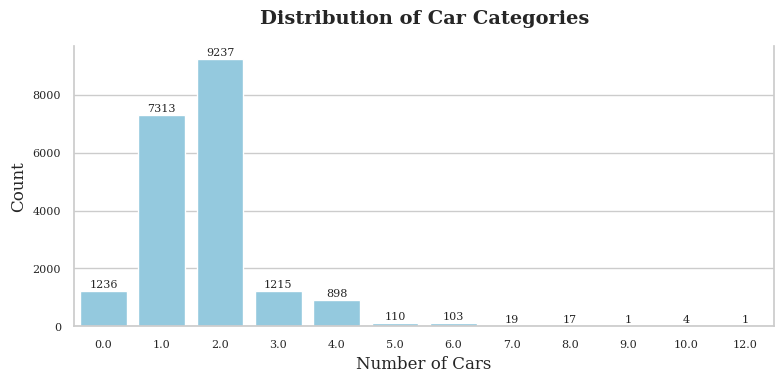

In [66]:
car_counts = Counter(df[~df['Car'].isnull()]['Car'])
# Convert the Counter object to a list of tuples and sort it for plotting
sorted_car_counts = sorted(car_counts.items())

# Separate keys and values for plotting
car_categories, car_frequencies = zip(*sorted_car_counts)
# Set the plot style
sns.set(style="whitegrid")

# Set the font to 'serif' for consistency with previous visual
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 12  # Set consistent font size

# Create a smaller bar plot
fig, ax = plt.subplots(figsize=(8, 4))  # Smaller size
sns.barplot(x=list(car_categories), y=list(car_frequencies), color='skyblue', ax=ax)

# Remove the top spine
ax.spines['top'].set_visible(False)

# Add titles and labels with consistent font
ax.set_title('Distribution of Car Categories', fontsize=14, weight='bold',y=1.05)
ax.set_xlabel('Number of Cars', fontsize=12)
ax.set_ylabel('Count', fontsize=12)

# Adjust tick font size for both x and y axis
ax.tick_params(axis='both', labelsize=8)  # Set y-tick label size

# Annotate each bar with the count value
for i, (category, frequency) in enumerate(sorted_car_counts):
    ax.text(i, frequency + 50, f'{frequency}', ha='center', va='bottom', fontsize=8)

# Show the plot
plt.tight_layout()
plt.show()

We corrected some extremely faulty values. But as previous we need to be cautious when dealing with this variable. We need collapse some caetgories so let's collapse all houses with 6 or more parking spaces during comparison.

In [68]:
df_car = df.copy()
df_car = df[~df_car['Car'].isnull()]
df_car.loc[:,'Car'] = df_car['Car'].apply(lambda x: 6 if x>=6 else x)

Measuring the association as previous.

In [70]:
contingency_table_car = pd.crosstab(df_car['Type'],df_car['Car'])
association(contingency_table,method= 'cramer',correction=True)

0.4560865689787933

In [71]:
chi2_stat_car, p_val_car, dof_car, expected_car = chi2_contingency(contingency_table_car)
print('Chi-squared =',chi2_stat_car)
print('P-value =', p_val_car)

Chi-squared = 3458.454736011445
P-value = 0.0


Check for expected values less than 5 (if True this invalidates our test)

In [73]:
expected_df_car = pd.DataFrame(expected_car, index=contingency_table_car.index, columns=contingency_table_car.columns)
print('Is the assumption violated?',(expected_car<5).any(),'\n')
expected_df_car.round()

Is the assumption violated? False 



Car,0.0,1.0,2.0,3.0,4.0,5.0,6.0
Type,,,,,,,
"house,cottage,villa, semi,terrace",929.0,5498.0,6944.0,913.0,675.0,83.0,109.0
townhouse,96.0,566.0,715.0,94.0,70.0,9.0,11.0
"unit, duplex",211.0,1249.0,1577.0,207.0,153.0,19.0,25.0


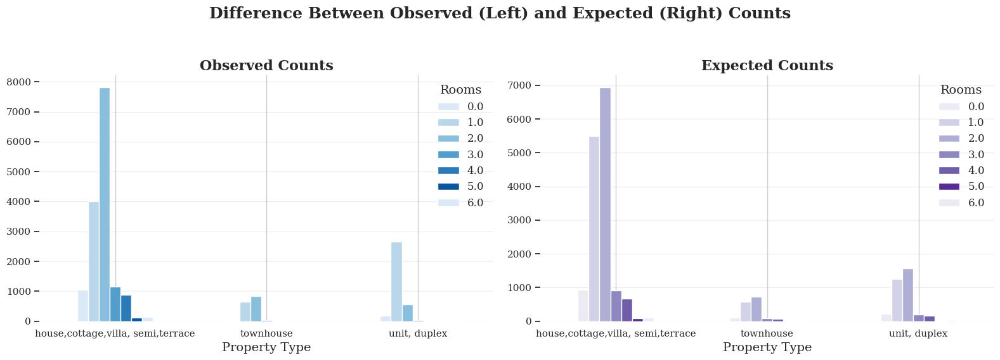

In [74]:
# Set the font to 'serif' for consistency
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 14

# Create the subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))
fig.suptitle("Difference Between Observed (Left) and Expected (Right) Counts", fontsize=18, weight='bold')

# Define the color palettes with better contrast
observed_colors = sns.color_palette("Blues", n_colors=6)  # Saturated blue palette for observed counts
expected_colors = sns.color_palette("Purples", n_colors=6)  # Saturated purple palette for expected counts

# Plot observed frequencies using Seaborn
contingency_table_car.plot(
    kind='bar', stacked=False, ax=axes[0], color=observed_colors, yerr=None, zorder=2)

# Customize the left axis plot
axes[0].set_title("Observed Counts", fontsize=16, weight='bold')
axes[0].set_xlabel('Property Type', fontsize=14)
axes[0].tick_params(axis='x', rotation=0, size=12, pad=10)
axes[0].tick_params(axis='y', left=True)
axes[0].set_frame_on(False)
axes[0].legend(title='Rooms', fontsize=12, title_fontsize=14, loc='upper right', frameon=False)
axes[0].tick_params(axis='x', which='both', length=0)
axes[0].grid(axis='y', alpha=0.3, zorder=0)

# Plot expected frequencies using Seaborn
expected_df_car.plot(
    kind='bar', stacked=False, ax=axes[1], color=expected_colors, yerr=None, zorder=2)

# Customize the right axis plot
axes[1].set_title("Expected Counts", fontsize=16, weight='bold')
axes[1].set_xlabel('Property Type', fontsize=14)
axes[1].tick_params(axis='x', rotation=0, size=12, pad=10)
axes[1].tick_params(axis='y', left=True)
axes[1].set_frame_on(False)
axes[1].legend(title='Rooms', fontsize=12, title_fontsize=14, loc='upper right', frameon=False)
axes[1].tick_params(axis='x', which='both', length=0)
axes[1].grid(axis='y', alpha=0.3, zorder=0)

# Adjust layout to prevent overlap and ensure space for the title
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.show()

* Significance of Differences: The differences between expected and observed counts for parking slots, particularly for 1 and 6 car spots, show why these results are statistically significant. Similar observations apply to townhouses and units, where the expected versus observed counts differ.

* Townhouses: For townhouses, the observed and expected counts are nearly identical, suggesting that the variation may be due to chance rather than any strong association with the type of property.

* Parkings for Units and Duplexes: The data suggests that unit owners usually have only one parking spot. Units with two spots are less common, and more than two spots are extremely rare. Units with more than two parking spots may hold unique value because of their rarity and should be considered carefully during valuation.

* Townhouses: Most townhouses have either one or two parking spots. Fewer or more than this is rare, indicating that the intended buyers of townhouses typically need at least one spot, with two being the more popular choice.

* Townhouses vs units: Although they maybe different with respect to their proportions having 2 or less parkings they are simillar in counts for any higher than 3 and even the difference in proportion doesn't seem significant.

* Diversity in Housing Options: There is a wide variety of parking options for houses, which may result from factors like location and the developer. This diversity may influence buyer preferences, property valuations.

1- **Non-Random Sample**: The current sample is not random or carefully selected, meaning any inferences made from it cannot be confidently generalized to the population. The data includes suburbs outside Melbourne, which further limits generlization.

2- **Suburb-Specific Analysis**: If the data were limited to Melbourne suburbs, more accurate inferences could be made about those specific areas during the time period under study.

3- **Ignoring Time**: The analysis so far has ignored the time dimension. Even with sufficient and properly sampled data, any inferences would only reflect the situation at that specific time. While relationships may remain consistent, the strength of those relationships could change over time.

After such an important remark let's continue questioning our data.
Which type of prorperty has the lowest number of parkings available?  
To answer this we need to think in terms of proprtions rather than counts. Which type of property has the lowest or highest proportion of a number of parking spots?

In [78]:
car_counts = df_car.groupby(['Type', 'Car']).size().unstack(fill_value=0)
totals = car_counts.sum(axis=1)

proportions = car_counts.div(totals, axis=0)


In [79]:
# Perform pairwise Z-test for each room category
car_categories = car_counts.columns

# Perform pairwise Z-test for each car category
for car in car_categories:
    print(f"\n{'-'*40}")
    print(f"Pairwise Z-tests for {int(car)} cars")
    print(f"{'-'*40}")
    
    # Get the counts and totals for each property type for this car category
    counts = car_counts[car]
    nobs = totals
    
    # Generate all pairwise combinations of property types
    comparisons = list(combinations(car_counts.index, 2))
    
    # Perform Z-tests for each pair of property types
    for i, j in comparisons:
        count = [counts[i], counts[j]]
        nobs_pair = [nobs[i], nobs[j]]
        
        # Perform the Z-test
        stat, pval = proportions_ztest(count, nobs_pair)
        
        # Print results in a formatted way
        print(f"Comparison between {i} and {j}:")
        print(f"  Z-statistic = {stat:.4f}")
        print(f"  P-value     = {pval:.4f}\n")
    
    print(f"{'-'*90}\n")


----------------------------------------
Pairwise Z-tests for 0 cars
----------------------------------------
Comparison between house,cottage,villa, semi,terrace and townhouse:
  Z-statistic = 8.6296
  P-value     = 0.0000

Comparison between house,cottage,villa, semi,terrace and unit, duplex:
  Z-statistic = 3.8989
  P-value     = 0.0001

Comparison between townhouse and unit, duplex:
  Z-statistic = -6.4077
  P-value     = 0.0000

------------------------------------------------------------------------------------------


----------------------------------------
Pairwise Z-tests for 1 cars
----------------------------------------
Comparison between house,cottage,villa, semi,terrace and townhouse:
  Z-statistic = -12.8345
  P-value     = 0.0000

Comparison between house,cottage,villa, semi,terrace and unit, duplex:
  Z-statistic = -56.2018
  P-value     = 0.0000

Comparison between townhouse and unit, duplex:
  Z-statistic = -24.6606
  P-value     = 0.0000

-------------------------

Summary:  
* **Weird Parking trend**: Houses are more likely to have no parking than units (ACCORING TO THE DATA), and units are more likely to have no parking than townhouses. This might be due to sampling issues, using common sense we know something is not right. So it

* **Parking for Units**: Units usually have one parking spot, but it’s rare for them to have two.

* **More Parking Spots**: Houses are most likely to have three or more parking spots, while it’s rare for units and townhouses. Beyond three spots, units and townhouses are equally unlikely to have that many, compared to houses.

* **Sanity Check**: The data aligns with expectations about houses having more parking spots, which makes sense.

* **Valuation Challenge**: Valuing units or townhouses with more than two parking spots is tricky because there isn’t much data, they could be worth more due to their rarity or because the intended owners are not likely to need this. Of course this will be case by case but we shall not expect too much from the model for such rare occasions if we were to use this as input.

We are not going to think about pricing for this feature. Why?  
Not enough data and we will dispose of it any ways during modeling.  

Now for the elephant in the room, but first we need a plot!

In [83]:
# Step 1: Calculate 10 quantiles
quantiles = df['Price'].quantile([x for x in np.linspace(0, 1, 11)])

# Step 2: Compute the percentage contribution of prices within each quantile range
total_sum = df['Price'].sum()
quantile_contributions = []
prev = 0
for q in quantiles:
    if q == quantiles.max():  # Include the upper bound for the last quantile
        quantile_contributions.append((df[(df['Price'] >= prev) & (df['Price'] <= q)]['Price'].sum() / total_sum) * 100)
    else:  # Exclude the upper bound for all other quantiles
        quantile_contributions.append((df[(df['Price'] >= prev) & (df['Price'] < q)]['Price'].sum() / total_sum) * 100)
    prev = q

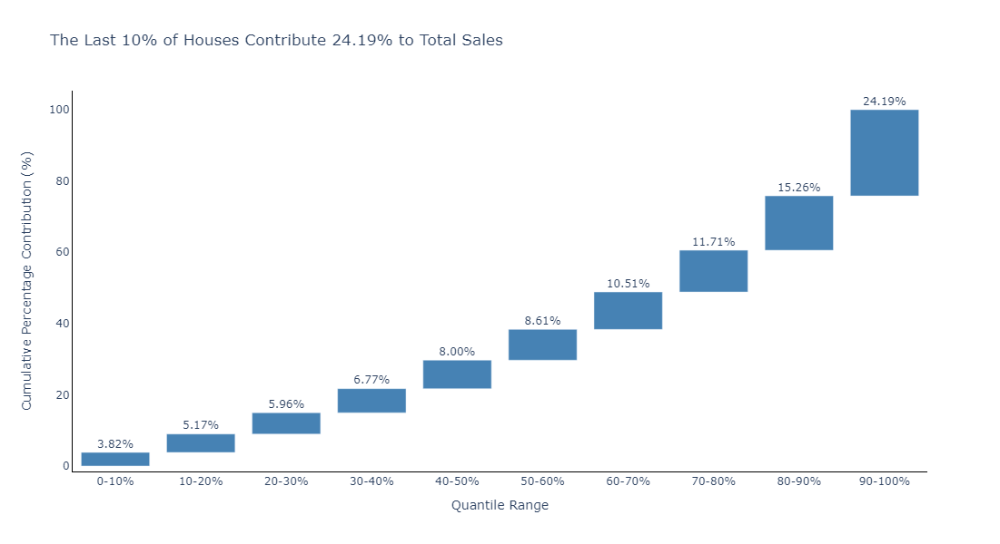

In [84]:
quantile_contributions = quantile_contributions[1:]
## Create a cumulative sum for the bottom positions of the bars
cumulative = np.cumsum(quantile_contributions)

# Define the labels for each quantile
labels = ['0-10%', '10-20%', '20-30%', '30-40%', '40-50%', 
          '50-60%', '60-70%', '70-80%', '80-90%', '90-100%']

# Single color for all bars
bar_color = 'steelblue'  # You can adjust this to any color you prefer

# Create the waterfall chart
fig = go.Figure()

# Add bars to the chart with a single color
for i in range(len(quantile_contributions)):
    fig.add_trace(go.Bar(
        x=[labels[i]],
        y=[quantile_contributions[i]],
        base=[cumulative[i-1] if i > 0 else 0],
        marker_color=bar_color,
        text=f'{quantile_contributions[i]:.2f}%',
        textposition='outside',
        name=labels[i]
    ))

# Update the layout
fig.update_layout(
    title='The Last 10% of Houses Contribute 24.19% to Total Sales',
    xaxis_title='Quantile Range',
    yaxis_title='Cumulative Percentage Contribution (%)',
    showlegend=False,
    height=600,
    width=900,
    plot_bgcolor='white',
    xaxis=dict(tickfont=dict(size=12), showline=True, linewidth=1, linecolor='black'),  # Show x-axis spine
    yaxis=dict(tickfont=dict(size=12), showline=True, linewidth=1, linecolor='black', showgrid=False),  # Show y-axis spine
)

# Display the chart
fig.show()

Remember the data is about the prices of the houses that were **sold**. This gives us a couple insights.  
* **Market condition**: 10% of the houses sold made about 24% of the total market value at that time. So most of the money moving was among the wealthies. Even the 80-90% bracket had 15% which is too much and explains the no distribution we saw at the begining.
* **Developers Concern**: Developers in such a market can think up different strategies.
  * Those who will build cheaper properties will not have a big share of the total market value but will have more customers, although not high paying.
  * Those who will focus on building the expensive properties will face the risk that comes with such high value properties. The market might crach (which is a matter of time), and their target customers are too few to depend on and losing one customer will be devastating. Any sort of flactuations will significantly hit the company's revenue.

**Personally** I see its safer to focus on the lower valued properties ,acquire more customers and extract value from them later. This market will force the developers of lower valued properties to focus on developing their unique selling point as for most people its the slight differences that matter for the final decision.  
Now the big question. Why are they expensive? let's try to find out.

In [86]:
top_10 = df[ (df['Price']>=quantiles[0.9]) & (df['Price']<=quantiles[1])]

In [87]:
# what are the types of such properties?
Counter(top_10['Type'])

Counter({'house,cottage,villa, semi,terrace': 2597,
         'townhouse': 86,
         'unit, duplex': 52})

Supprisingly there are a couple units in there.  
Let's see how the price is distributed among the top 10

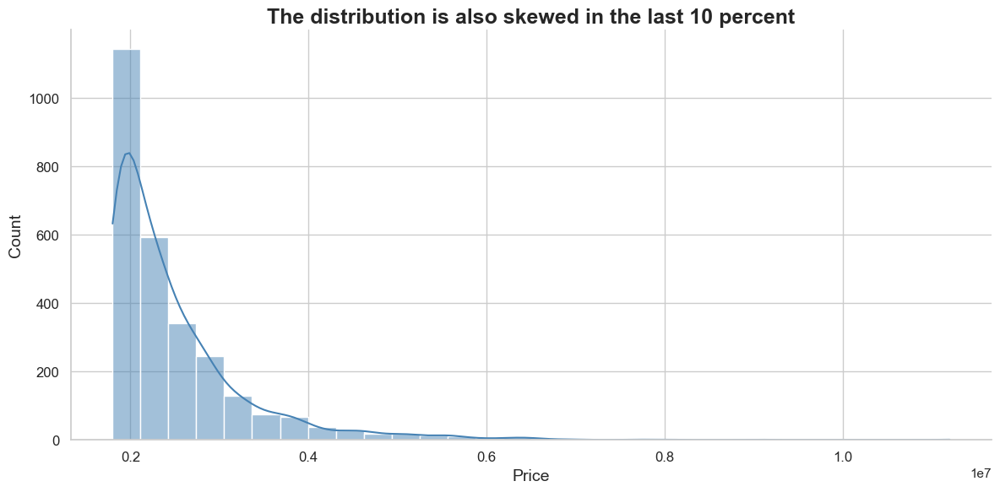

In [89]:
# Set the style and color palette
sns.set(style="whitegrid")

# Create the histogram plot with improved aesthetics
plt.figure(figsize=(12, 6))
sns.histplot(top_10['Price'], kde=True, color="steelblue", bins=30)

# Customize the axes, title, and labels for better readability
plt.title('The distribution is also skewed in the last 10 percent', fontsize=18, weight='bold')
plt.xlabel('Price', fontsize=14)
plt.ylabel('Count', fontsize=14)

# Remove top and right spines for a cleaner look
sns.despine()

# Set tick sizes
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

Even their price here is skewed so much.  
Let's look at each type alone.  We start by the most amusing one, Units.  
We mainly want to see what percentage do they make out of the total, do they have something special? more rooms? more bathrooms? we also want to see them on the map.

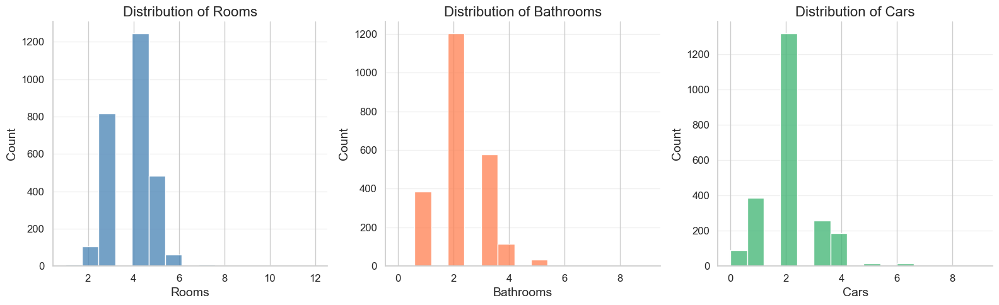

In [91]:
# Set the style for the plots
sns.set(style="whitegrid")

# Create the subplots
fig, axes = plt.subplots(ncols=3, figsize=(16, 5))

# Customize and plot each histogram with better aesthetics
sns.histplot(top_10['Rooms'], ax=axes[0], color="steelblue", bins=15)
sns.histplot(top_10['Bathroom'], ax=axes[1], color="coral", bins=15)
sns.histplot(top_10['Car'], ax=axes[2], color="mediumseagreen", bins=15)

# Set titles for each subplot
axes[0].set_title('Distribution of Rooms', fontsize=16)
axes[1].set_title('Distribution of Bathrooms', fontsize=16)
axes[2].set_title('Distribution of Cars', fontsize=16)

# Set axis labels
axes[0].set_xlabel('Rooms', fontsize=14)
axes[1].set_xlabel('Bathrooms', fontsize=14)
axes[2].set_xlabel('Cars', fontsize=14)

# Set y-axis labels
axes[0].set_ylabel('Count', fontsize=14)
axes[1].set_ylabel('Count', fontsize=14)
axes[2].set_ylabel('Count', fontsize=14)

# Remove unnecessary spines and adjust layout
for ax in axes:
    sns.despine(ax=ax)  # Remove top and right spines
    ax.grid(True, axis='y', alpha=0.3)  # Add subtle gridlines
    ax.tick_params(axis='both', which='major', labelsize=12)  # Set tick size

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()

* We have got most of the outliers in the features. In rooms, bathroom and car slots. This is interesting to see. This goes with the association we saw earlier between price and these features.
* Most of the properties with the highest prices are Houses (Which makes since.) but there are some units.
* Most of the influence in the histograms might be attributed to houses' dominance in numbers. So we need to see the same plots for each type separately.

In [93]:
df['Type'].unique()

array(['house,cottage,villa, semi,terrace', 'townhouse', 'unit, duplex'],
      dtype=object)

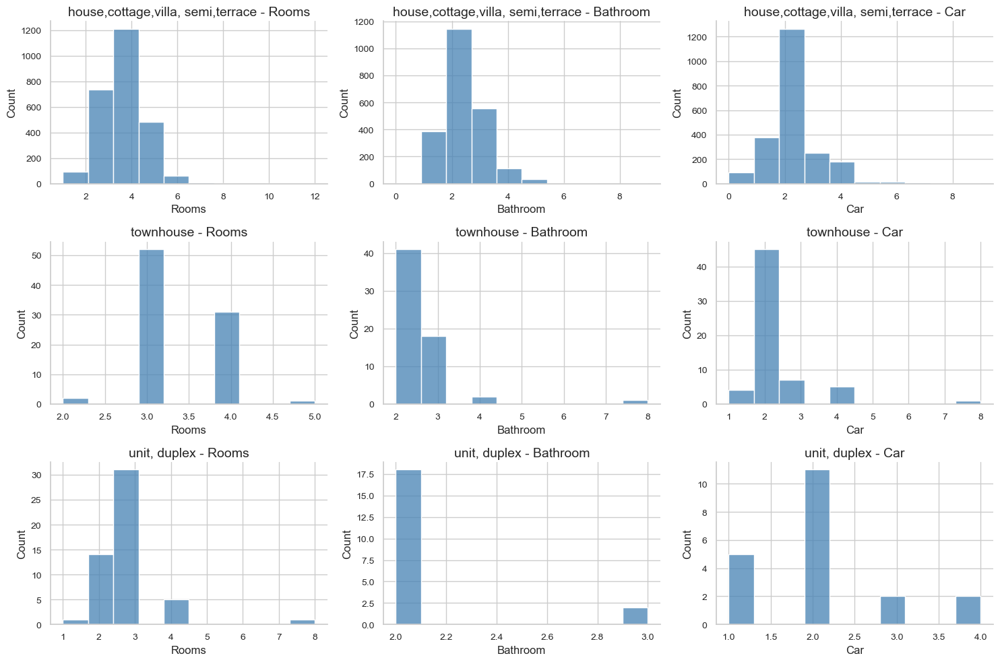

In [94]:
# Set the style for the plots
sns.set(style="whitegrid")

# Create the 3x3 subplots
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 10))

# Define the property types and corresponding variable names
property_types = ['house,cottage,villa, semi,terrace', 'townhouse', 'unit, duplex']
variables = ['Rooms', 'Bathroom', 'Car']

# Loop over property types and variables
for i, prop_type in enumerate(property_types):
    for j, variable in enumerate(variables):
        # Plot each histogram and set the color
        sns.histplot(top_10[top_10['Type'] == prop_type][variable], ax=axes[i, j], color="steelblue", bins=10)
        
        # Set the title for each plot
        axes[i, j].set_title(f'{prop_type} - {variable}', fontsize=14)
        
        # Set the labels
        axes[i, j].set_xlabel(variable, fontsize=12)
        axes[i, j].set_ylabel('Count', fontsize=12)
        
        # Remove top and right spines for a cleaner look
        sns.despine(ax=axes[i, j])

        # Adjust tick parameters for better readability
        axes[i, j].tick_params(axis='both', which='major', labelsize=10)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()

Is it worth looking at the raw data? not really. Just by eye-balling the counts of the extreme values we see that we don't even have **all** the extreme outliers in those 10%.  
Let's check the suburbs.

We see A lot of the suburbs we mentioned under the first map. It's sad that we don't have a lot of sample for some suburbs.  
This further confirms the importance of having the location as an input. While we don't have a lot of features for the properties themselves to work with, we can use other pieces of information like the type, the location, and surrounding amenities to predict the price.  
We will discuss modeling considerations later.  
For now this is the finish line!